In [1]:
import pandas as pd
from wordcloud import WordCloud
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import mplcursors
import plotly.express as px

In [2]:
df = pd.read_table('/Users/janna.rittmeyer/Desktop/DATA/Python/Projekte/Netflix/netflix_titles.csv', sep=',')
df.head()

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,Movie,Dick Johnson Is Dead,Kirsten Johnson,NaN,United States,"September 25, 2021",2020,PG-13,90 min,Documentaries,"As her father nears the end of his life, filmm..."
1,s2,TV Show,Blood & Water,NaN,"Ama Qamata, Khosi Ngema, Gail Mabalane, Thaban...",South Africa,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, TV Dramas, TV Mysteries","After crossing paths at a party, a Cape Town t..."
2,s3,TV Show,Ganglands,Julien Leclercq,"Sami Bouajila, Tracy Gotoas, Samuel Jouy, Nabi...",NaN,"September 24, 2021",2021,TV-MA,1 Season,"Crime TV Shows, International TV Shows, TV Act...",To protect his family from a powerful drug lor...
3,s4,TV Show,Jailbirds New Orleans,NaN,NaN,NaN,"September 24, 2021",2021,TV-MA,1 Season,"Docuseries, Reality TV","Feuds, flirtations and toilet talk go down amo..."
4,s5,TV Show,Kota Factory,NaN,"Mayur More, Jitendra Kumar, Ranjan Raj, Alam K...",India,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, Romantic TV Shows, TV ...",In a city of coaching centers known to train I...


## EDA & Data Cleaning

In [4]:
# set show_id as index
df1 = df.set_index('show_id')
df1

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
show_id,,,,,,,,,,,
s1,Movie,Dick Johnson Is Dead,Kirsten Johnson,NaN,United States,"September 25, 2021",2020,PG-13,90 min,Documentaries,"As her father nears the end of his life, filmm..."
s2,TV Show,Blood & Water,NaN,"Ama Qamata, Khosi Ngema, Gail Mabalane, Thaban...",South Africa,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, TV Dramas, TV Mysteries","After crossing paths at a party, a Cape Town t..."
s3,TV Show,Ganglands,Julien Leclercq,"Sami Bouajila, Tracy Gotoas, Samuel Jouy, Nabi...",NaN,"September 24, 2021",2021,TV-MA,1 Season,"Crime TV Shows, International TV Shows, TV Act...",To protect his family from a powerful drug lor...
s4,TV Show,Jailbirds New Orleans,NaN,NaN,NaN,"September 24, 2021",2021,TV-MA,1 Season,"Docuseries, Reality TV","Feuds, flirtations and toilet talk go down amo..."
s5,TV Show,Kota Factory,NaN,"Mayur More, Jitendra Kumar, Ranjan Raj, Alam K...",India,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, Romantic TV Shows, TV ...",In a city of coaching centers known to train I...
...,...,...,...,...,...,...,...,...,...,...,...
s8803,Movie,Zodiac,David Fincher,"Mark Ruffalo, Jake Gyllenhaal, Robert Downey J...",United States,"November 20, 2019",2007,R,158 min,"Cult Movies, Dramas, Thrillers","A political cartoonist, a crime reporter and a..."
s8804,TV Show,Zombie Dumb,NaN,NaN,NaN,"July 1, 2019",2018,TV-Y7,2 Seasons,"Kids' TV, Korean TV Shows, TV Comedies","While living alone in a spooky town, a young g..."
s8805,Movie,Zombieland,Ruben Fleischer,"Jesse Eisenberg, Woody Harrelson, Emma Stone, ...",United States,"November 1, 2019",2009,R,88 min,"Comedies, Horror Movies",Looking to survive in a world taken over by zo...


In [5]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8807 entries, s1 to s8807
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   type          8807 non-null   object
 1   title         8807 non-null   object
 2   director      6173 non-null   object
 3   cast          7982 non-null   object
 4   country       7976 non-null   object
 5   date_added    8797 non-null   object
 6   release_year  8807 non-null   int64 
 7   rating        8803 non-null   object
 8   duration      8804 non-null   object
 9   listed_in     8807 non-null   object
 10  description   8807 non-null   object
dtypes: int64(1), object(10)
memory usage: 825.7+ KB


In [6]:
# delete spaces in date_added
df1['date_added'] = df1['date_added'].str.strip()

In [7]:
# convert date_added to datetime fomat
df1['date_added'] = pd.to_datetime(df1['date_added'])
df1

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
show_id,,,,,,,,,,,
s1,Movie,Dick Johnson Is Dead,Kirsten Johnson,NaN,United States,2021-09-25,2020,PG-13,90 min,Documentaries,"As her father nears the end of his life, filmm..."
s2,TV Show,Blood & Water,NaN,"Ama Qamata, Khosi Ngema, Gail Mabalane, Thaban...",South Africa,2021-09-24,2021,TV-MA,2 Seasons,"International TV Shows, TV Dramas, TV Mysteries","After crossing paths at a party, a Cape Town t..."
s3,TV Show,Ganglands,Julien Leclercq,"Sami Bouajila, Tracy Gotoas, Samuel Jouy, Nabi...",NaN,2021-09-24,2021,TV-MA,1 Season,"Crime TV Shows, International TV Shows, TV Act...",To protect his family from a powerful drug lor...
s4,TV Show,Jailbirds New Orleans,NaN,NaN,NaN,2021-09-24,2021,TV-MA,1 Season,"Docuseries, Reality TV","Feuds, flirtations and toilet talk go down amo..."
s5,TV Show,Kota Factory,NaN,"Mayur More, Jitendra Kumar, Ranjan Raj, Alam K...",India,2021-09-24,2021,TV-MA,2 Seasons,"International TV Shows, Romantic TV Shows, TV ...",In a city of coaching centers known to train I...
...,...,...,...,...,...,...,...,...,...,...,...
s8803,Movie,Zodiac,David Fincher,"Mark Ruffalo, Jake Gyllenhaal, Robert Downey J...",United States,2019-11-20,2007,R,158 min,"Cult Movies, Dramas, Thrillers","A political cartoonist, a crime reporter and a..."
s8804,TV Show,Zombie Dumb,NaN,NaN,NaN,2019-07-01,2018,TV-Y7,2 Seasons,"Kids' TV, Korean TV Shows, TV Comedies","While living alone in a spooky town, a young g..."
s8805,Movie,Zombieland,Ruben Fleischer,"Jesse Eisenberg, Woody Harrelson, Emma Stone, ...",United States,2019-11-01,2009,R,88 min,"Comedies, Horror Movies",Looking to survive in a world taken over by zo...


In [8]:
# check for duplicates => Result: no duplicates
duplicates = df1[df1.duplicated()]
print(duplicates)

Empty DataFrame
Columns: [type, title, director, cast, country, date_added, release_year, rating, duration, listed_in, description]
Index: []


In [9]:
# duplicates of title => Result: no duplicates in title, which means only unique movies are in the list
duplicates_title = df1[df1.duplicated(subset=['title'])]
print(duplicates_title)

Empty DataFrame
Columns: [type, title, director, cast, country, date_added, release_year, rating, duration, listed_in, description]
Index: []


In [10]:
# sum of NULL values per column 
df1.isnull().sum()

type               0
title              0
director        2634
cast             825
country          831
date_added        10
release_year       0
rating             4
duration           3
listed_in          0
description        0
dtype: int64

In [11]:
df1

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
show_id,,,,,,,,,,,
s1,Movie,Dick Johnson Is Dead,Kirsten Johnson,NaN,United States,2021-09-25,2020,PG-13,90 min,Documentaries,"As her father nears the end of his life, filmm..."
s2,TV Show,Blood & Water,NaN,"Ama Qamata, Khosi Ngema, Gail Mabalane, Thaban...",South Africa,2021-09-24,2021,TV-MA,2 Seasons,"International TV Shows, TV Dramas, TV Mysteries","After crossing paths at a party, a Cape Town t..."
s3,TV Show,Ganglands,Julien Leclercq,"Sami Bouajila, Tracy Gotoas, Samuel Jouy, Nabi...",NaN,2021-09-24,2021,TV-MA,1 Season,"Crime TV Shows, International TV Shows, TV Act...",To protect his family from a powerful drug lor...
s4,TV Show,Jailbirds New Orleans,NaN,NaN,NaN,2021-09-24,2021,TV-MA,1 Season,"Docuseries, Reality TV","Feuds, flirtations and toilet talk go down amo..."
s5,TV Show,Kota Factory,NaN,"Mayur More, Jitendra Kumar, Ranjan Raj, Alam K...",India,2021-09-24,2021,TV-MA,2 Seasons,"International TV Shows, Romantic TV Shows, TV ...",In a city of coaching centers known to train I...
...,...,...,...,...,...,...,...,...,...,...,...
s8803,Movie,Zodiac,David Fincher,"Mark Ruffalo, Jake Gyllenhaal, Robert Downey J...",United States,2019-11-20,2007,R,158 min,"Cult Movies, Dramas, Thrillers","A political cartoonist, a crime reporter and a..."
s8804,TV Show,Zombie Dumb,NaN,NaN,NaN,2019-07-01,2018,TV-Y7,2 Seasons,"Kids' TV, Korean TV Shows, TV Comedies","While living alone in a spooky town, a young g..."
s8805,Movie,Zombieland,Ruben Fleischer,"Jesse Eisenberg, Woody Harrelson, Emma Stone, ...",United States,2019-11-01,2009,R,88 min,"Comedies, Horror Movies",Looking to survive in a world taken over by zo...


In [12]:
# check if type has to be corrected => only 2 values ('Movie', 'TV Show') and no cleaning necessary
unique_type = df1['type'].unique()
unique_type

array(['Movie', 'TV Show'], dtype=object)

In [13]:
# check if rating has to be corrected => values that are no valid rating 
unique_rating = df1['rating'].unique()
unique_rating

array(['PG-13', 'TV-MA', 'PG', 'TV-14', 'TV-PG', 'TV-Y', 'TV-Y7', 'R',
       'TV-G', 'G', 'NC-17', '74 min', '84 min', '66 min', 'NR', nan,
       'TV-Y7-FV', 'UR'], dtype=object)

In [14]:
# create list mit valid ratings
valid_ratings = ['PG-13', 'TV-MA', 'PG', 'TV-14', 'TV-PG', 'TV-Y', 'TV-Y7', 'R', 'TV-G', 'G', 'NC-17', 'TV-Y7-FV', 'UR', 'NR']

df1_invalid_rating = df1[~df1['rating'].isin(valid_ratings)]
pd.set_option('display.max_rows', None)
df1_invalid_rating

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
show_id,,,,,,,,,,,
s5542,Movie,Louis C.K. 2017,Louis C.K.,Louis C.K.,United States,2017-04-04,2017,74 min,NaN,Movies,"Louis C.K. muses on religion, eternal love, gi..."
s5795,Movie,Louis C.K.: Hilarious,Louis C.K.,Louis C.K.,United States,2016-09-16,2010,84 min,NaN,Movies,Emmy-winning comedy writer Louis C.K. brings h...
s5814,Movie,Louis C.K.: Live at the Comedy Store,Louis C.K.,Louis C.K.,United States,2016-08-15,2015,66 min,NaN,Movies,The comic puts his trademark hilarious/thought...
s5990,Movie,13TH: A Conversation with Oprah Winfrey & Ava ...,NaN,"Oprah Winfrey, Ava DuVernay",NaN,2017-01-26,2017,NaN,37 min,Movies,Oprah Winfrey sits down with director Ava DuVe...
s6828,TV Show,Gargantia on the Verdurous Planet,NaN,"Kaito Ishikawa, Hisako Kanemoto, Ai Kayano, Ka...",Japan,2016-12-01,2013,NaN,1 Season,"Anime Series, International TV Shows","After falling through a wormhole, a space-dwel..."
s7313,TV Show,Little Lunch,NaN,"Flynn Curry, Olivia Deeble, Madison Lu, Oisín ...",Australia,2018-02-01,2015,NaN,1 Season,"Kids' TV, TV Comedies","Adopting a child's perspective, this show take..."
s7538,Movie,My Honor Was Loyalty,Alessandro Pepe,"Leone Frisa, Paolo Vaccarino, Francesco Miglio...",Italy,2017-03-01,2015,NaN,115 min,Dramas,"Amid the chaos and horror of World War II, a c..."


In [15]:
mask = df1['rating'].str.contains(r'^\d+\s*min$', na=False)
df1.loc[mask, 'duration'] = df1.loc[mask, 'rating']

df1.loc[mask, 'rating'] = np.nan

In [16]:
valid_ratings = ['PG-13', 'TV-MA', 'PG', 'TV-14', 'TV-PG', 'TV-Y', 'TV-Y7', 'R', 'TV-G', 'G', 'NC-17', 'TV-Y7-FV', 'UR', 'NR']

df1_invalid_rating = df1[~df1['rating'].isin(valid_ratings)]
pd.set_option('display.max_rows', None)
df1_invalid_rating

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
show_id,,,,,,,,,,,
s5542,Movie,Louis C.K. 2017,Louis C.K.,Louis C.K.,United States,2017-04-04,2017,NaN,74 min,Movies,"Louis C.K. muses on religion, eternal love, gi..."
s5795,Movie,Louis C.K.: Hilarious,Louis C.K.,Louis C.K.,United States,2016-09-16,2010,NaN,84 min,Movies,Emmy-winning comedy writer Louis C.K. brings h...
s5814,Movie,Louis C.K.: Live at the Comedy Store,Louis C.K.,Louis C.K.,United States,2016-08-15,2015,NaN,66 min,Movies,The comic puts his trademark hilarious/thought...
s5990,Movie,13TH: A Conversation with Oprah Winfrey & Ava ...,NaN,"Oprah Winfrey, Ava DuVernay",NaN,2017-01-26,2017,NaN,37 min,Movies,Oprah Winfrey sits down with director Ava DuVe...
s6828,TV Show,Gargantia on the Verdurous Planet,NaN,"Kaito Ishikawa, Hisako Kanemoto, Ai Kayano, Ka...",Japan,2016-12-01,2013,NaN,1 Season,"Anime Series, International TV Shows","After falling through a wormhole, a space-dwel..."
s7313,TV Show,Little Lunch,NaN,"Flynn Curry, Olivia Deeble, Madison Lu, Oisín ...",Australia,2018-02-01,2015,NaN,1 Season,"Kids' TV, TV Comedies","Adopting a child's perspective, this show take..."
s7538,Movie,My Honor Was Loyalty,Alessandro Pepe,"Leone Frisa, Paolo Vaccarino, Francesco Miglio...",Italy,2017-03-01,2015,NaN,115 min,Dramas,"Amid the chaos and horror of World War II, a c..."


In [17]:
# check data in column release_year
unique_release_year = sorted(df1['release_year'].unique())
unique_release_year

[1925,
 1942,
 1943,
 1944,
 1945,
 1946,
 1947,
 1954,
 1955,
 1956,
 1958,
 1959,
 1960,
 1961,
 1962,
 1963,
 1964,
 1965,
 1966,
 1967,
 1968,
 1969,
 1970,
 1971,
 1972,
 1973,
 1974,
 1975,
 1976,
 1977,
 1978,
 1979,
 1980,
 1981,
 1982,
 1983,
 1984,
 1985,
 1986,
 1987,
 1988,
 1989,
 1990,
 1991,
 1992,
 1993,
 1994,
 1995,
 1996,
 1997,
 1998,
 1999,
 2000,
 2001,
 2002,
 2003,
 2004,
 2005,
 2006,
 2007,
 2008,
 2009,
 2010,
 2011,
 2012,
 2013,
 2014,
 2015,
 2016,
 2017,
 2018,
 2019,
 2020,
 2021]

In [18]:
df2 = df1.copy(deep=True)
df2

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
show_id,,,,,,,,,,,
s1,Movie,Dick Johnson Is Dead,Kirsten Johnson,NaN,United States,2021-09-25,2020,PG-13,90 min,Documentaries,"As her father nears the end of his life, filmm..."
s2,TV Show,Blood & Water,NaN,"Ama Qamata, Khosi Ngema, Gail Mabalane, Thaban...",South Africa,2021-09-24,2021,TV-MA,2 Seasons,"International TV Shows, TV Dramas, TV Mysteries","After crossing paths at a party, a Cape Town t..."
s3,TV Show,Ganglands,Julien Leclercq,"Sami Bouajila, Tracy Gotoas, Samuel Jouy, Nabi...",NaN,2021-09-24,2021,TV-MA,1 Season,"Crime TV Shows, International TV Shows, TV Act...",To protect his family from a powerful drug lor...
s4,TV Show,Jailbirds New Orleans,NaN,NaN,NaN,2021-09-24,2021,TV-MA,1 Season,"Docuseries, Reality TV","Feuds, flirtations and toilet talk go down amo..."
s5,TV Show,Kota Factory,NaN,"Mayur More, Jitendra Kumar, Ranjan Raj, Alam K...",India,2021-09-24,2021,TV-MA,2 Seasons,"International TV Shows, Romantic TV Shows, TV ...",In a city of coaching centers known to train I...
s6,TV Show,Midnight Mass,Mike Flanagan,"Kate Siegel, Zach Gilford, Hamish Linklater, H...",NaN,2021-09-24,2021,TV-MA,1 Season,"TV Dramas, TV Horror, TV Mysteries",The arrival of a charismatic young priest brin...
s7,Movie,My Little Pony: A New Generation,"Robert Cullen, José Luis Ucha","Vanessa Hudgens, Kimiko Glenn, James Marsden, ...",NaN,2021-09-24,2021,PG,91 min,Children & Family Movies,Equestria's divided. But a bright-eyed hero be...
s8,Movie,Sankofa,Haile Gerima,"Kofi Ghanaba, Oyafunmike Ogunlano, Alexandra D...","United States, Ghana, Burkina Faso, United Kin...",2021-09-24,1993,TV-MA,125 min,"Dramas, Independent Movies, International Movies","On a photo shoot in Ghana, an American model s..."
s9,TV Show,The Great British Baking Show,Andy Devonshire,"Mel Giedroyc, Sue Perkins, Mary Berry, Paul Ho...",United Kingdom,2021-09-24,2021,TV-14,9 Seasons,"British TV Shows, Reality TV",A talented batch of amateur bakers face off in...


## Data Analysis

In [20]:
print(sns.palettes.SEABORN_PALETTES.keys())

dict_keys(['deep', 'deep6', 'muted', 'muted6', 'pastel', 'pastel6', 'bright', 'bright6', 'dark', 'dark6', 'colorblind', 'colorblind6'])


In [21]:
palette = sns.color_palette('pastel')

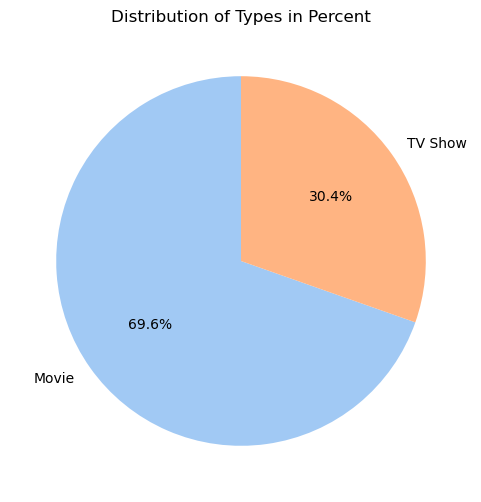

In [22]:
# Pie Chart to show split between TV Shows and Movies

type_percent = df1['type'].value_counts(normalize=True) * 100

type_percent.plot(kind='pie', autopct='%1.1f%%', figsize=(6, 6), startangle=90, colors=palette)
plt.title('Distribution of Types in Percent')
plt.ylabel('')
plt.show()


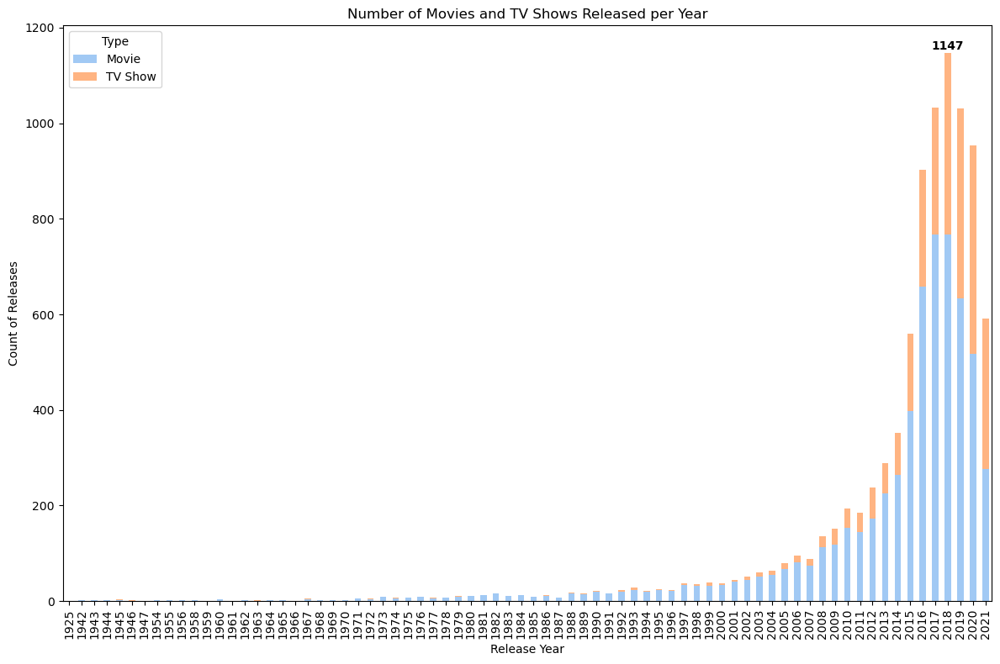

In [23]:
# Stacked bar chart showing Movies and TV Shows released per year

grouped = df1.groupby(['release_year', 'type']).size().unstack().fillna(0)

ax = grouped.plot(kind='bar', stacked=True, figsize=(12, 8), color=palette)
plt.title('Number of Movies and TV Shows Released per Year')
plt.xlabel('Release Year')
plt.ylabel('Count of Releases')

mplcursors.cursor(ax.patches, hover=True)

highest_total_idx = grouped.sum(axis=1).idxmax()
highest_total = grouped.loc[highest_total_idx].sum()

x_position = grouped.index.get_loc(highest_total_idx)
label = f'{int(highest_total)}'
ax.text(x_position, highest_total + 1, label, ha='center', va='bottom', fontsize=10, fontweight='bold', color='black')

plt.xticks(rotation=90)
plt.legend(title='Type', labels=['Movie', 'TV Show'])

plt.tight_layout()
plt.show()


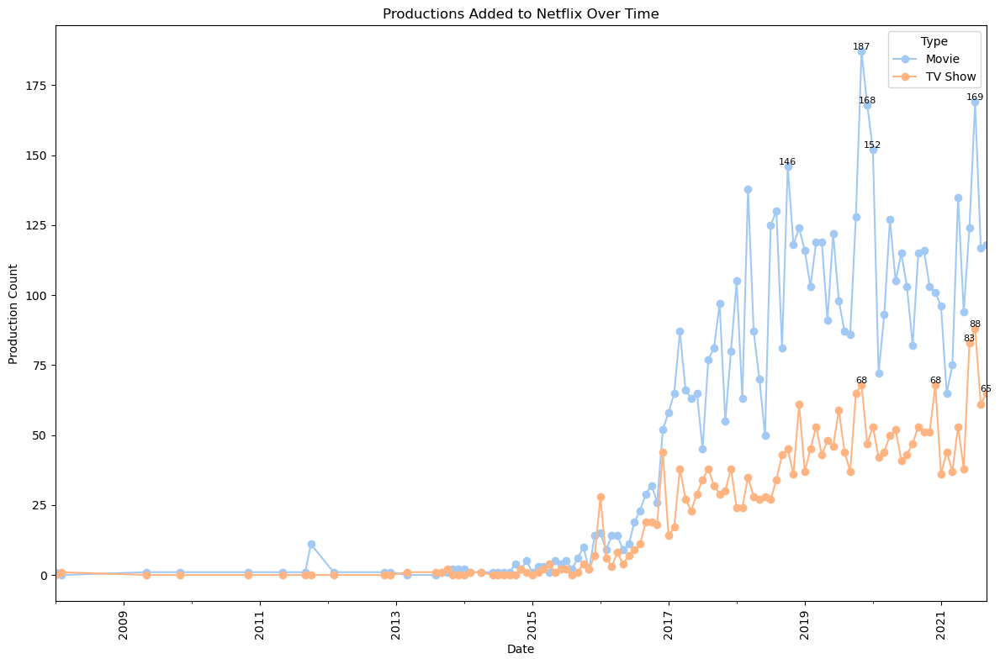

In [24]:
# Line chart showing productions added to Netflix over time

grouped_line = df1.groupby([df1['date_added'].dt.to_period('M'), 'type']).size().unstack().fillna(0)

ax = grouped_line.plot(kind='line', figsize=(12, 8), marker='o', color=palette)
plt.title('Productions Added to Netflix Over Time')
plt.xlabel('Date')
plt.ylabel('Production Count')

plt.xticks(rotation=90)

plt.legend(title='Type', labels=['Movie', 'TV Show'])

for i, line in enumerate(ax.get_lines()):
    sorted_y_data = sorted(zip(line.get_ydata(), line.get_xdata()), reverse=True)[:5]
    
    for y_val, x_val in sorted_y_data:
        ax.text(x_val, y_val, f'{int(y_val)}', ha='center', va='bottom', fontsize=8, color='black')

plt.tight_layout()
plt.show()

In [25]:
# Group by year and sum the counts
yearly_counts = df1.groupby(df1['date_added'].dt.year)['type'].value_counts().unstack().fillna(0)

print(yearly_counts)

type         Movie  TV Show
date_added                 
2008.0         1.0      1.0
2009.0         2.0      0.0
2010.0         1.0      0.0
2011.0        13.0      0.0
2012.0         3.0      0.0
2013.0         6.0      5.0
2014.0        19.0      5.0
2015.0        56.0     26.0
2016.0       253.0    176.0
2017.0       839.0    349.0
2018.0      1237.0    412.0
2019.0      1424.0    592.0
2020.0      1284.0    595.0
2021.0       993.0    505.0


In [26]:
# Number of productions per country
df_countries = df1[['title', 'country']].copy()
df_countries

,title,country
show_id,,
s1,Dick Johnson Is Dead,United States
s2,Blood & Water,South Africa
s3,Ganglands,NaN
s4,Jailbirds New Orleans,NaN
s5,Kota Factory,India
s6,Midnight Mass,NaN
s7,My Little Pony: A New Generation,NaN
s8,Sankofa,"United States, Ghana, Burkina Faso, United Kin..."
s9,The Great British Baking Show,United Kingdom


In [27]:
df_countries['country'] = df_countries['country'].str.split(',')

In [28]:
df_countries_exploded = df_countries.assign(listed_in=df_countries['country'].str.split(', ')).explode('country')

In [29]:
df_countries_exploded['country'] = df_countries_exploded['country'].str.strip()

In [30]:
country_counts = df_countries_exploded['country'].value_counts().reset_index()
country_counts.columns = ['country', 'count']

In [31]:
palette = sns.color_palette('pastel', n_colors=len(country_counts))
palette_hex = palette.as_hex()

In [32]:
fig_country = px.treemap(
    country_counts,
    path=['country'],  
    values='count', 
    color='count',
    color_continuous_scale=palette_hex,  
    title="Distribution of Productions per Country in Netflix Library",
)

fig_country.update_traces(
    textinfo="label+value+percent root",  
    insidetextfont=dict(size=12, color='black')  
)

fig_country.update_layout(
    title_font=dict(size=20, color='black'),
    title_x=0.5, 
    width=1200, 
    height=600,
    paper_bgcolor="white", 
    plot_bgcolor="white",  
    margin=dict(l=0, r=0, t=30, b=0)  
)

fig_country.show()

In [33]:
# Distribution of genres for movies
df_genres = df1[['title', 'type', 'listed_in']].copy()
df_genres

,title,type,listed_in
show_id,,,
s1,Dick Johnson Is Dead,Movie,Documentaries
s2,Blood & Water,TV Show,"International TV Shows, TV Dramas, TV Mysteries"
s3,Ganglands,TV Show,"Crime TV Shows, International TV Shows, TV Act..."
s4,Jailbirds New Orleans,TV Show,"Docuseries, Reality TV"
s5,Kota Factory,TV Show,"International TV Shows, Romantic TV Shows, TV ..."
s6,Midnight Mass,TV Show,"TV Dramas, TV Horror, TV Mysteries"
s7,My Little Pony: A New Generation,Movie,Children & Family Movies
s8,Sankofa,Movie,"Dramas, Independent Movies, International Movies"
s9,The Great British Baking Show,TV Show,"British TV Shows, Reality TV"


In [34]:
df_genres_exploded = df_genres.assign(listed_in=df_genres['listed_in'].str.split(', ')).explode('listed_in')

In [35]:
df_genres_exploded['listed_in'] = df_genres_exploded['listed_in'].str.strip()

In [36]:
df_movies = df_genres_exploded[df_genres_exploded['type'] == 'Movie']
df_shows = df_genres_exploded[df_genres_exploded['type'] == 'TV Show']

In [37]:
genre_count_movies = df_movies['listed_in'].value_counts().reset_index()
genre_count_movies.columns = ['listed_in', 'count']

In [38]:
palette_movies = sns.color_palette('pastel', n_colors=len(genre_count_movies))
palette_movies_hex = palette_movies.as_hex()

In [39]:
fig_movies = px.treemap(genre_count_movies,
                         path=['listed_in'],  
                         values='count',  
                         title="Distribution of Genres for Movies",
                         color='count',  
                         color_continuous_scale=palette_movies_hex,  
                         hover_data=['listed_in', 'count']  
                        )


fig_movies.update_traces(
    textinfo="label+value+percent root",  
    insidetextfont=dict(size=12, color='black')  
)

fig_movies.update_layout(
    title_font=dict(size=20, color='black'),
    title_x=0.5, 
    width=1100,
    height=600,
    paper_bgcolor="white",
    plot_bgcolor="white",
    margin=dict(l=0, r=0, t=30, b=0)
)


fig_movies.show()

In [40]:
# Distribution of genres for movies
genre_count_shows = df_shows['listed_in'].value_counts().reset_index()
genre_count_shows.columns = ['listed_in', 'count']

In [41]:
palette_shows = sns.color_palette('pastel', n_colors=len(genre_count_shows))
palette_shows_hex = palette_shows.as_hex()

In [42]:
fig_shows = px.treemap(genre_count_shows,
                         path=['listed_in'],  
                         values='count',  
                         title="Distribution of Genres for TV Shows",
                         color='count',  
                         color_continuous_scale=palette_shows_hex,  
                         hover_data=['listed_in', 'count']  
                        )

fig_shows.update_traces(
    textinfo="label+value+percent root",  
    insidetextfont=dict(size=12, color='black')  
)

fig_shows.update_layout(
    title_font=dict(size=20, color='black'),
    title_x=0.5, 
    width=1100,
    height=600,
    paper_bgcolor="white",
    plot_bgcolor="white",
    margin=dict(l=0, r=0, t=30, b=0)
)


fig_shows.show()

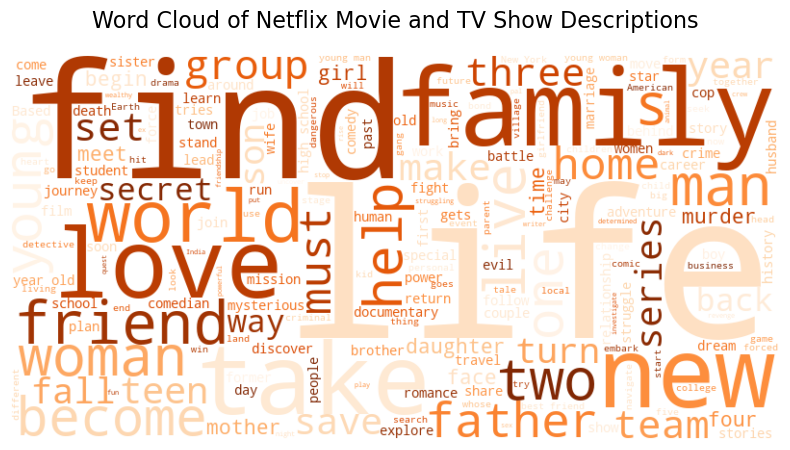

In [43]:
# Wordcloud to find themes in descriptions
text = " ".join(description for description in df1['description'])

wordcloud_description = WordCloud(width=800, height=400, background_color='white', colormap='Oranges').generate(text)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud_description, interpolation='bilinear')
plt.axis('off') 
plt.title('Word Cloud of Netflix Movie and TV Show Descriptions', fontsize=16, pad=20)
plt.show()

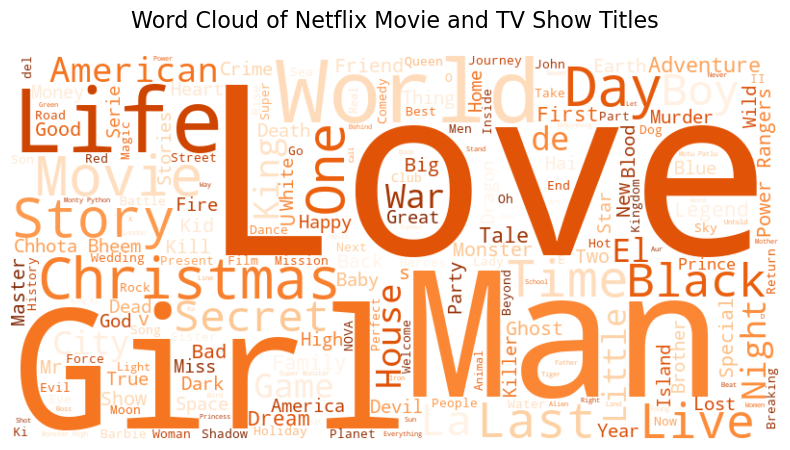

In [44]:
# Wordcloud to find themes in titles
text_titles = " ".join(title for title in df1['title'])

wordcloud_title = WordCloud(width=800, height=400, background_color='white', colormap='Oranges').generate(text_titles)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud_title, interpolation='bilinear')
plt.axis('off') 
plt.title('Word Cloud of Netflix Movie and TV Show Titles', fontsize=16, pad=20)
plt.show()